# **Emotion Detection from Images using Machine Learning**

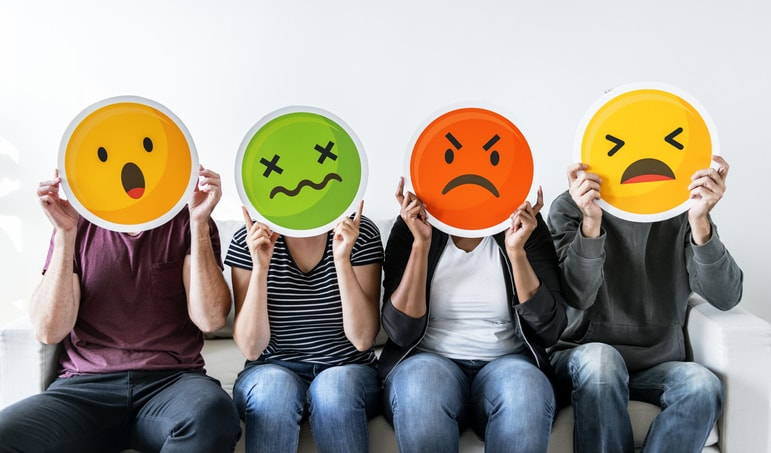

##**Introduction:**

In human communications, facial expressions contain critical nonverbal information that can provide additional clues and meanings to verbal communications. Some studies have suggested that 60–80% of communication is nonverbal. This nonverbal information includes facial expressions, eye contact, tones of voice, hand gestures and physical distancing. In particular, facial expression analysis has become a popular research topic.



##**Problem Statement:**

Our aim is to develope a Machine Learning model that is capable of detecting the emotion from the face in the input image.

##**How machine learning can be used to solve this problem?**

Here, our input is Image data and the output is single label indicating the corresponding emotion. We can use the existing image data to make Machine Learning model learn the underlying relationship between the input images and output class label.

Once the model learns this relationship, we can use it to predict the corresponding emotion from the person's face in the input image.

##**Literature Survey:**

To understand the Problem Statement thoroughly and to learn various possible approaches, following research papers and/or blogs were referred.
1.	https://www.sciencedirect.com/science/article/pii/S1877050920318019
2.	https://edps.europa.eu/system/files/2021-05/21-05-26_techdispatch-facial-emotion-recognition_ref_en.pdf
3.	https://arxiv.org/pdf/1804.08348.pdf
4.	https://www.robots.ox.ac.uk/~vgg/publications/2015/Parkhi15/parkhi15.pdf  


##**Necessary Libraries**

In [1]:
# Importing Necessary Libraries
import warnings
warnings.filterwarnings('ignore')
import gdown
import os
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import seaborn as sns
import cv2
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.preprocessing import OneHotEncoder
import tensorflow as tf
from tensorflow.keras import Input
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.callbacks import ReduceLROnPlateau
from tensorflow.keras.callbacks import TensorBoard
from tensorflow.keras.layers import Flatten, Conv2D, GlobalAveragePooling2D
from tensorflow.keras.layers import MaxPooling2D, AveragePooling2D, Flatten
from tensorflow.keras.layers import Dropout, BatchNormalization, Activation
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import VGG19

RANDOM_SEED = 111

##**Performance Metrics:**

Since it is a Multi Class Clasiification problem, following Metrics can be used to monitor and compare performance of various ML models and best performing model can be selected.

1. Accuracy (https://scikit-learn.org/stable/modules/generated/sklearn.metrics.accuracy_score.html#sklearn.metrics.accuracy_score)
2. Weighted_F1_score (https://scikit-learn.org/stable/modules/generated/sklearn.metrics.f1_score.html#sklearn.metrics.f1_score)
3. Confusion Matrix (https://scikit-learn.org/stable/modules/generated/sklearn.metrics.confusion_matrix.html)

##**About Dataset:**

**Data Source:** https://www.kaggle.com/datasets/ashishpatel26/facial-expression-recognitionferchallenge/data

Data is zipped in single archive.zip file and has size 96.59 MB.

Archive.zip can be unzipped into the following folder structure
<pre>
archive.zip
     |
     |--- Submission.csv(7.01KB)
     |
     |--- fer2013
            |
            |---fer2013
                   |
                   |--- README(476 B)
                   |--- fer2013.bib(1.36 KB)
                   |--- fer2013.csv(287.13 MB)
</pre>

File fer2013.csv contains the image pixel values and the corresponding class labels.

### Download and Read the data

In [2]:
# Downloading data using gdown
!gdown 1pKOyT-wtAyNHAe6966BbFBQnNK5arll4

Downloading...
From: https://drive.google.com/uc?id=1pKOyT-wtAyNHAe6966BbFBQnNK5arll4
To: /content/archive.zip
100% 101M/101M [00:01<00:00, 88.7MB/s] 


In [3]:
# Extracting archive.zip file
!unzip /content/archive.zip

Archive:  /content/archive.zip
  inflating: Submission.csv          
  inflating: fer2013/fer2013/README  
  inflating: fer2013/fer2013/fer2013.bib  
  inflating: fer2013/fer2013/fer2013.csv  


In [4]:
# Reading the data
data_df = pd.read_csv('/content/fer2013/fer2013/fer2013.csv')
data_df.head()

,emotion,pixels,Usage
0,0,70 80 82 72 58 58 60 63 54 58 60 48 89 115 121...,Training
1,0,151 150 147 155 148 133 111 140 170 174 182 15...,Training
2,2,231 212 156 164 174 138 161 173 182 200 106 38...,Training
3,4,24 32 36 30 32 23 19 20 30 41 21 22 32 34 21 1...,Training
4,6,4 0 0 0 0 0 0 0 0 0 0 0 3 15 23 28 48 50 58 84...,Training


### Exploring the data

In [5]:
# Check data size
data_df.shape

(35887, 3)

In [6]:
# Check image size
sample = data_df['pixels'][0]
pixels_length = len(sample.split())
img_size = np.sqrt(pixels_length)
print(f"Each image is of size {img_size} * {img_size}")

Each image is of size 48.0 * 48.0


In [7]:
# Data info
data_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35887 entries, 0 to 35886
Data columns (total 3 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   emotion  35887 non-null  int64 
 1   pixels   35887 non-null  object
 2   Usage    35887 non-null  object
dtypes: int64(1), object(2)
memory usage: 841.2+ KB


In [8]:
# Check null values
data_df.isnull().sum()

emotion    0
pixels     0
Usage      0
dtype: int64

In [9]:
# Check duplicates
print(f"Duplicate values count: {data_df.duplicated().sum()}")

Duplicate values count: 1234


In [10]:
# Drop duplicates
data_df.drop_duplicates(keep='first', inplace=True)

In [11]:
# Data size after dropping duplicates
data_df.shape

(34653, 3)

In [12]:
# Unique class labels
u = np.unique(data_df['emotion'])
print(f"There are {len(u)} unique emotions {u}")

There are 7 unique emotions [0 1 2 3 4 5 6]


In [13]:
#Text to numerical labeling
emotions_labels = {0:'anger', 1:'disgust', 2:'fear', 3:'happiness', 4: 'sadness', 5: 'surprise', 6: 'neutral'}
emotion_list = list(emotions_labels.values())

3    8859
6    6105
4    5977
2    4925
0    4800
5    3496
1     491
Name: emotion, dtype: int64

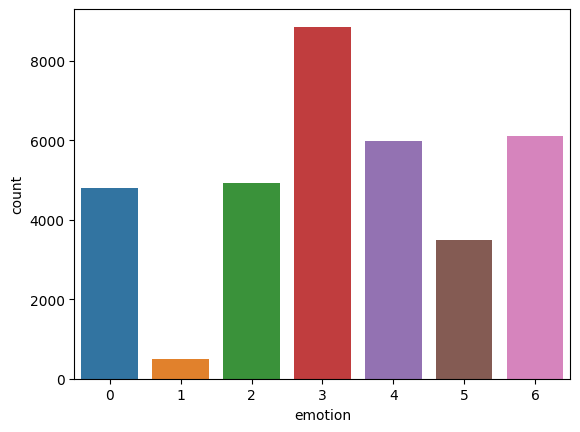

In [14]:
# Emotions distribution
sns.countplot(x=data_df['emotion'])
data_df['emotion'].value_counts()

**Observation(s):**

1. fer2013.csv file contains 3 columns emotion, pixels, Usage


    *   emotion -> id of the enotion
    *   pixels -> flattened array of pixel values in the image
    *   Usage -> string indicating training or test image
2. Data contains 35887 images with corresponding class labels.
3. There are 1234 duplicate images which are dropped to get 34653 unique images
4. There are no null values in the dataset
5. There are 7 unique emotions
<pre> 0:'anger', 1:'disgust', 2:'fear', 3:'happiness', 4: 'sadness', 5: 'surprise', 6: 'neutral' </pre>
6. Emotions distibution in imbalanced with only 491 unique images for 'disgust' emotion, all other emotions have at least 3400 images.


### Viewing Sample Images

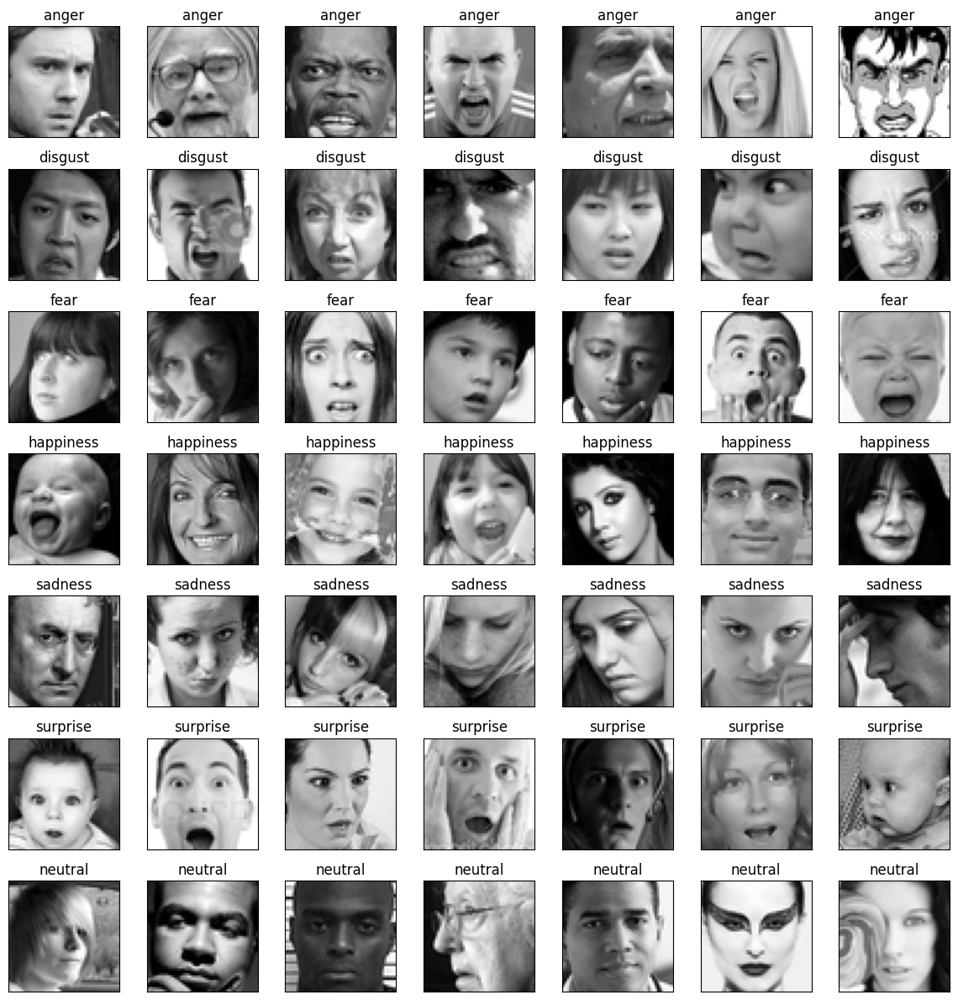

In [15]:
#Viewing the images
fig = plt.figure(1, (12, 12))
k = 0
for label in sorted(data_df.emotion.unique()):
    for j in range(7):
        px = data_df[data_df.emotion==label].pixels.iloc[k]
        px = np.array(px.split(' ')).reshape(48, 48).astype('float32')
        k += 1
        ax = plt.subplot(7, 7, k)
        ax.imshow(px, cmap = 'gray')
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_title(emotions_labels[label])
        plt.tight_layout()

##**Pre-processing Data for Model Training**

### Data preparation for ML Models

Here we will split the pixels value string into individual pixel value columns. This pre processing will help us in training ML Classification models and Deep MLP models.

In [16]:
# Copying df
ml_data_df = data_df.copy()

# Drop unwanted columns
ml_data_df = ml_data_df.drop('Usage', axis=1)
ml_data_df.columns

Index(['emotion', 'pixels'], dtype='object')

In [17]:
# Splitting pixel string and creating separate column for each pixel value
new_cols = list(range(0, 2304))
ml_data_df[new_cols] = data_df['pixels'].str.split(' ', expand=True)
ml_data_df = ml_data_df.drop('pixels', axis=1)
ml_data_df.head()

,emotion,0,1,2,3,4,5,6,7,8,...,2294,2295,2296,2297,2298,2299,2300,2301,2302,2303
0,0,70,80,82,72,58,58,60,63,54,...,159,182,183,136,106,116,95,106,109,82
1,0,151,150,147,155,148,133,111,140,170,...,105,108,95,108,102,67,171,193,183,184
2,2,231,212,156,164,174,138,161,173,182,...,104,138,152,122,114,101,97,88,110,152
3,4,24,32,36,30,32,23,19,20,30,...,174,126,132,132,133,136,139,142,143,142
4,6,4,0,0,0,0,0,0,0,0,...,12,34,31,31,31,27,31,30,29,30


In [18]:
with open('ml_data_df.csv', mode='w') as f:
    ml_data_df.to_csv(f)

### Data Preparation for DL Models

Here we will convert the pixels value strings into 2d image array and further into rgb image which can be used to train CNN models.

In [19]:
# Split pixel values and convert to 2d array
img_array = data_df['pixels'].apply(lambda x: np.array(x.split(' ')).reshape(48, 48).astype('float32'))
img_array = np.stack(img_array, axis = 0)
img_array.shape

(34653, 48, 48)

In [20]:
# Converting image arrays to rgb images
img_data = []

for i in range(len(img_array)):
    img = cv2.cvtColor(img_array[i], cv2.COLOR_GRAY2RGB)
    img_data.append(img)

img_data = np.array(img_data)
print(img_data.shape)

(34653, 48, 48, 3)


In [21]:
# Saving img_data array
with open('image_data.npy', mode='wb') as f:
    np.save(f, img_data)

In [22]:
# Saving labels array
labels = np.array(data_df['emotion'].values)

with open('labels.npy', mode='wb') as f:
    np.save(f, labels)

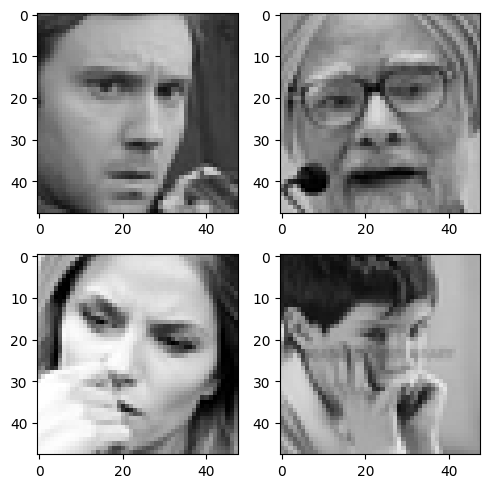

In [23]:
# View processed rgb image samples
fig = plt.figure(1, (5, 5))
k = 1

for i in range(4):
    img = img_data[i].astype(np.uint8)
    plt.subplot(2,2,k)
    plt.imshow(img)
    plt.tight_layout()
    k+=1

##**Modelling Approaches**

Many different modelling experiments can be carried out in order to achieve the best performance for our classification task. Here we will experiment with 5 such approaches.

1. Multi Class Classification using SVM
2. Deep Multi-Layer Perceptron
3. Custom CNN Model
4. Transfer Learning using Pretrained CNN Model
5. Training State of the art CNN Model from scratch.

Defining custom function for model evaluation

In [24]:
def print_evaluation_metrics(true, pred, data_name:str):
    '''
    Evaluates accuracy score, weighted f1 score and plots confusion matrix for given true and predicted labels
    '''
    print('* *' * 25)
    # Accuracy
    acc = accuracy_score(true, pred)
    print(f"{data_name} data accuracy score: {acc}")
    # weighted f1 score
    f1 = f1_score(true, pred, average='weighted')
    print(f"{data_name} data weighted f1 score: {f1}")
    # Confusion matrix
    cmat = confusion_matrix(true, pred)
    plt.figure(figsize=(6,4))
    sns.heatmap(cmat, annot=True, fmt='02d', cmap="YlGnBu",xticklabels=emotion_list,
                yticklabels=emotion_list)
    plt.title(f'{data_name} data confusion matrix')
    plt.show()

In [25]:
def plot_metrics(history):
    '''
    Plots accuracy vs epoch and loss vs epoch plots for NN training.
    '''
    fig = plt.figure(figsize=(12, 4))

    ax = plt.subplot(1, 2, 1)
    sns.lineplot(x=history.epoch, y=history.history['accuracy'], label='train')
    sns.lineplot(x=history.epoch, y=history.history['val_accuracy'], label='valid')
    plt.title('Accuracy Vs Epoch')

    ax = plt.subplot(1, 2, 2)
    sns.lineplot(x=history.epoch, y=history.history['loss'], label='train')
    sns.lineplot(x=history.epoch, y=history.history['val_loss'], label='valid')
    plt.title('Loss Vs Epoch')

    plt.tight_layout()
    plt.show()

###1. Multi Class Classification using SVM

**Train-Cross_Validation-Test Split**

In [25]:
# Separating pixels and class labels
y = ml_data_df['emotion']
X = ml_data_df.drop('emotion', axis=1)

In [26]:
# Train Test Split (80-20 split)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y, random_state=RANDOM_SEED)

# Train CV Split (80-10 split)
X_train, X_cv, y_train, y_cv = train_test_split(X_train, y_train, test_size=0.1, stratify=y_train, random_state=RANDOM_SEED)

# Shapes
print(f'X_train shape: {X_train.shape}')
print(f'X_cv shape:    {X_cv.shape}')
print(f'X_test shape:  {X_test.shape}')
print(f'y_train shape: {y_train.shape}')
print(f'y_cv shape:    {y_cv.shape}')
print(f'y_test shape:  {y_test.shape}')

X_train shape: (24949, 2304)
X_cv shape:    (2773, 2304)
X_test shape:  (6931, 2304)
y_train shape: (24949,)
y_cv shape:    (2773,)
y_test shape:  (6931,)


**Normalizing Data**

In [27]:
# Min-Max Normalization
pixel_normalizer = MinMaxScaler()
pixel_normalizer.fit(X_train)

X_train_norm = pixel_normalizer.transform(X_train)
X_cv_norm = pixel_normalizer.transform(X_cv)
X_test_norm = pixel_normalizer.transform(X_test)

**Model Training**

In [28]:
# Params
kernel = 'rbf'
c = 1.0

In [29]:
# Base SVC Model
svm_rbf = SVC(C=c, kernel=kernel, degree=3)

# Train model
svm_rbf.fit(X_train_norm,y_train)

SVC()

In [30]:
# Predictions
X_train_pred = svm_rbf.predict(X_train_norm)
X_cv_pred = svm_rbf.predict(X_cv_norm)
X_test_pred = svm_rbf.predict(X_test_norm)

* ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** *
train data accuracy score: 0.6085614653893944
train data weighted f1 score: 0.5957275885795638


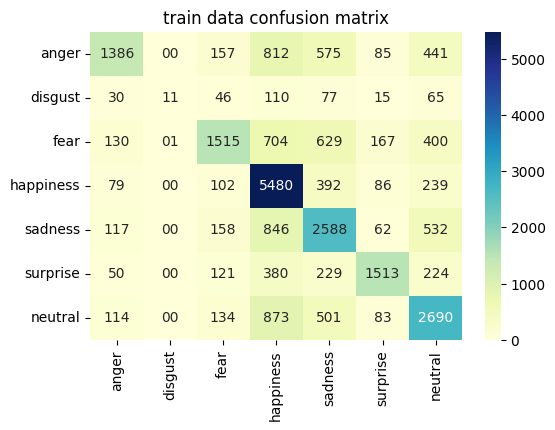

* ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** *
cv data accuracy score: 0.43310494049765597
cv data weighted f1 score: 0.4111602800742764


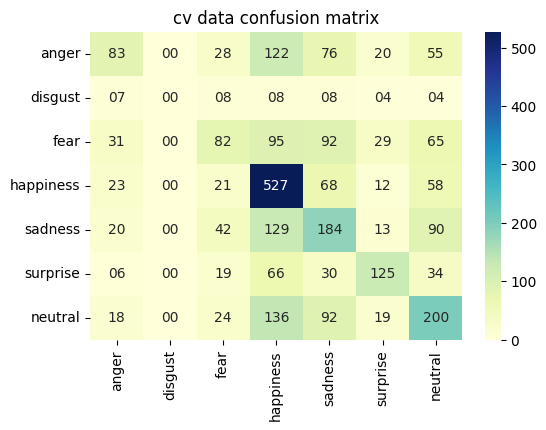

In [31]:
# Check Model performance
print_evaluation_metrics(y_train, X_train_pred, 'train')
print_evaluation_metrics(y_cv, X_cv_pred, 'cv')

* ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** *
test data accuracy score: 0.42764391862646084
test data weighted f1 score: 0.40433925845207547


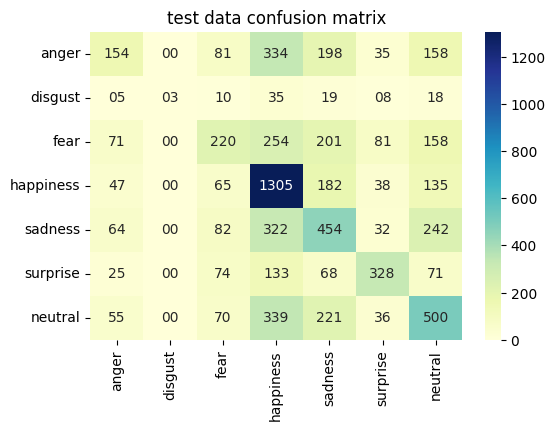

              precision    recall  f1-score   support

           0       0.37      0.16      0.22       960
           1       1.00      0.03      0.06        98
           2       0.37      0.22      0.28       985
           3       0.48      0.74      0.58      1772
           4       0.34      0.38      0.36      1196
           5       0.59      0.47      0.52       699
           6       0.39      0.41      0.40      1221

    accuracy                           0.43      6931
   macro avg       0.50      0.34      0.35      6931
weighted avg       0.43      0.43      0.40      6931



In [32]:
# Model performance on test data
print_evaluation_metrics(y_test, X_test_pred, 'test')
print(classification_report(y_test, X_test_pred))

###2. Deep Multi Layer Perceptron

**Train-Test Split**

In [33]:
# Separating pixels and class labels
y = ml_data_df['emotion']
X = ml_data_df.drop('emotion', axis=1)

In [34]:
# Train Test Split (80-20 split)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y, random_state=RANDOM_SEED)

# Train CV Split (80-10 split)
X_train, X_cv, y_train, y_cv = train_test_split(X_train, y_train, test_size=0.1, stratify=y_train, random_state=RANDOM_SEED)

# Shapes
print(f'X_train shape: {X_train.shape}')
print(f'X_cv shape:    {X_cv.shape}')
print(f'X_test shape:  {X_test.shape}')
print(f'y_train shape: {y_train.shape}')
print(f'y_cv shape:    {y_cv.shape}')
print(f'y_test shape:  {y_test.shape}')

X_train shape: (24949, 2304)
X_cv shape:    (2773, 2304)
X_test shape:  (6931, 2304)
y_train shape: (24949,)
y_cv shape:    (2773,)
y_test shape:  (6931,)


**Normalize pixel data**

In [35]:
# Min-Max Normalization
pixel_normalizer = MinMaxScaler()
pixel_normalizer.fit(X_train)

X_train_norm = pixel_normalizer.transform(X_train)
X_cv_norm = pixel_normalizer.transform(X_cv)
X_test_norm = pixel_normalizer.transform(X_test)

**Encode class labels**

In [36]:
# Encode class labels
ohe = OneHotEncoder()
ohe.fit(np.array(y_train).reshape(-1, 1))

y_train_enc = ohe.transform(np.array(y_train).reshape(-1,1)).todense()
y_cv_enc = ohe.transform(np.array(y_cv).reshape(-1,1)).todense()
y_test_enc = ohe.transform(np.array(y_test).reshape(-1,1)).todense()

# Shapes
print(f'y_train_enc shape: {y_train_enc.shape}')
print(f'y_cv_enc shape: {y_cv_enc.shape}')
print(f'y_test_enc shape: {y_test_enc.shape}')

y_train_enc shape: (24949, 7)
y_cv_enc shape: (2773, 7)
y_test_enc shape: (6931, 7)


**Define MLP Network**

In [37]:
# Defining MLP Model using tensorflow
mlp_model = tf.keras.Sequential()
mlp_model.add(Input(shape=(2304)))
mlp_model.add(Dense(512, activation='relu'))
mlp_model.add(Dropout(0.2))
mlp_model.add(Dense(256, activation='relu'))
mlp_model.add(Dropout(0.2))
mlp_model.add(Dense(128, activation='relu'))
mlp_model.add(Dense(64, activation='relu'))
mlp_model.add(Dense(16, activation='relu'))
mlp_model.add(Dense(7, activation='softmax'))

# Summary
mlp_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 512)               1180160   
                                                                 
 dropout (Dropout)           (None, 512)               0         
                                                                 
 dense_1 (Dense)             (None, 256)               131328    
                                                                 
 dropout_1 (Dropout)         (None, 256)               0         
                                                                 
 dense_2 (Dense)             (None, 128)               32896     
                                                                 
 dense_3 (Dense)             (None, 64)                8256      
                                                                 
 dense_4 (Dense)             (None, 16)                1

**Define Callbacks**

In [38]:
# Create necessary directories
os.makedirs('mlp/models', exist_ok=True)
os.makedirs('mlp/logs', exist_ok=True)

In [39]:
# Callbacks
saver = ModelCheckpoint('/content/mlp/models_{epoch:02d}.hdf5', monitor='val_loss', verbose=1, save_best_only=True)
stopper = EarlyStopping(monitor='val_loss', patience=7, restore_best_weights=True, verbose=1)
reducer = ReduceLROnPlateau(monitor='val_loss', factor=0.05, patience=5, verbose=1)
tb = TensorBoard(log_dir='/content/mlp/logs', histogram_freq=1)

callbacks = [saver, stopper, reducer, tb]

**Train Model**

In [40]:
# Params
optimizer = 'Adam'
loss = 'categorical_crossentropy'
metrics = ['accuracy']
batch_size = 8
epochs = 100

In [41]:
# Compile Model
mlp_model.compile(optimizer=optimizer, loss=loss, metrics=metrics)

In [42]:
# Train Model
mlp_history = mlp_model.fit(X_train_norm, y_train_enc, batch_size=batch_size, epochs=epochs,
                            callbacks=callbacks, validation_data=[X_cv_norm, y_cv_enc])

Epoch 1/100
3119/3119 [==============================] - ETA: 0s - loss: 1.8149 - accuracy: 0.2506
Epoch 1: val_loss improved from inf to 1.80648, saving model to /content/mlp/models_01.hdf5
3119/3119 [==============================] - 19s 4ms/step - loss: 1.8149 - accuracy: 0.2506 - val_loss: 1.8065 - val_accuracy: 0.2557 - lr: 0.0010
Epoch 2/100
3110/3119 [============================>.] - ETA: 0s - loss: 1.7932 - accuracy: 0.2556
Epoch 2: val_loss improved from 1.80648 to 1.76653, saving model to /content/mlp/models_02.hdf5
3119/3119 [==============================] - 12s 4ms/step - loss: 1.7930 - accuracy: 0.2556 - val_loss: 1.7665 - val_accuracy: 0.2557 - lr: 0.0010
Epoch 3/100
3118/3119 [============================>.] - ETA: 0s - loss: 1.7732 - accuracy: 0.2560
Epoch 3: val_loss improved from 1.76653 to 1.74104, saving model to /content/mlp/models_03.hdf5
3119/3119 [==============================] - 12s 4ms/step - loss: 1.7732 - accuracy: 0.2560 - val_loss: 1.7410 - val_accuracy

**Model Performance Metrics**

In [43]:
# Predictions
train_pred = np.argmax(mlp_model.predict(X_train_norm), axis=1)
cv_pred = np.argmax(mlp_model.predict(X_cv_norm), axis=1)
test_pred = np.argmax(mlp_model.predict(X_test_norm), axis=1)

217/217 [==============================] - 0s 1ms/step


In [44]:
# Tensorboard
%load_ext tensorboard
%tensorboard --logdir /content/mlp/logs

<IPython.core.display.Javascript object>

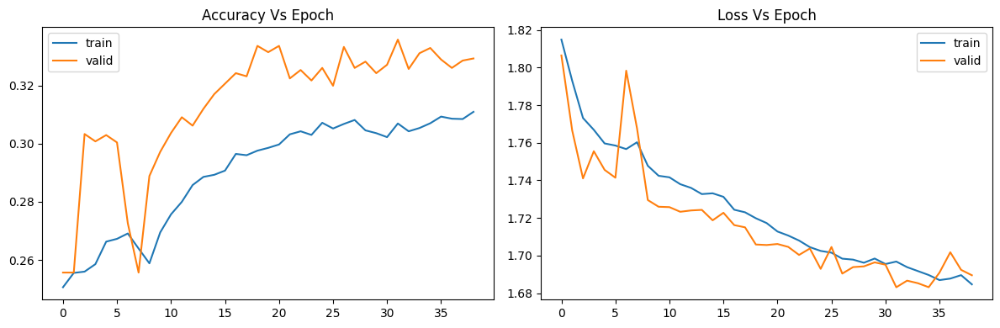

In [47]:
# Training Metrics
plot_metrics(mlp_history)

* ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** *
train data accuracy score: 0.3419776343741232
train data weighted f1 score: 0.27628898043110894


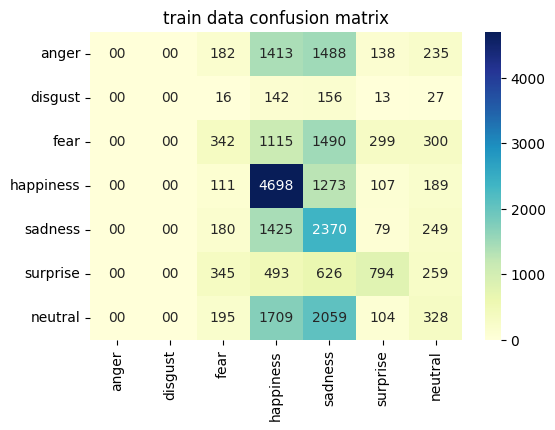

* ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** *
cv data accuracy score: 0.33573746844572666
cv data weighted f1 score: 0.2677314866452974


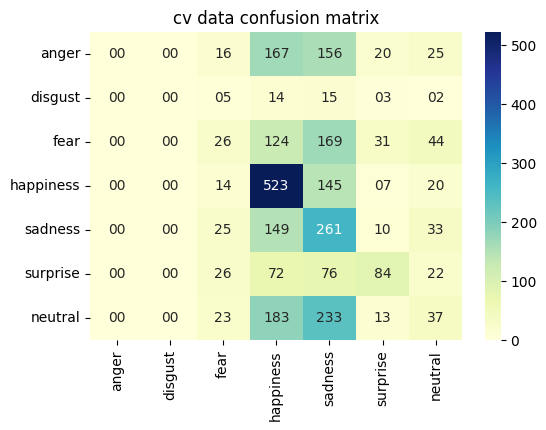

In [45]:
# Metrics
print_evaluation_metrics(y_train, train_pred, 'train')
print_evaluation_metrics(y_cv, cv_pred, 'cv')

* ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** *
test data accuracy score: 0.32823546385802915
test data weighted f1 score: 0.264818713353675


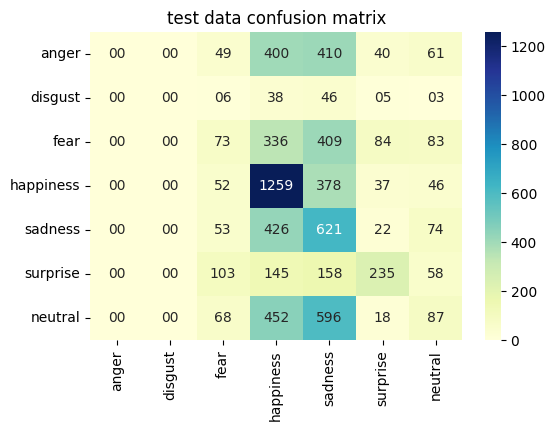

              precision    recall  f1-score   support

           0       0.00      0.00      0.00       960
           1       0.00      0.00      0.00        98
           2       0.18      0.07      0.11       985
           3       0.41      0.71      0.52      1772
           4       0.24      0.52      0.33      1196
           5       0.53      0.34      0.41       699
           6       0.21      0.07      0.11      1221

    accuracy                           0.33      6931
   macro avg       0.22      0.24      0.21      6931
weighted avg       0.26      0.33      0.26      6931



In [48]:
# Test Data Performance
print_evaluation_metrics(y_test, test_pred, 'test')
print(classification_report(y_test, test_pred))

###3. Custom CNN Model

**Train Test Split**

In [49]:
# Train Test Split (80-20 split)
X_train, X_test, y_train, y_test = train_test_split(img_data, labels, test_size=0.2, stratify=labels, random_state=RANDOM_SEED)

# Train CV Split (80-10 split)
X_train, X_cv, y_train, y_cv = train_test_split(X_train, y_train, test_size=0.1, stratify=y_train, random_state=RANDOM_SEED)

# Shapes
print(f'X_train shape: {X_train.shape}')
print(f'X_cv shape:    {X_cv.shape}')
print(f'X_test shape:  {X_test.shape}')
print(f'y_train shape: {y_train.shape}')
print(f'y_cv shape:    {y_cv.shape}')
print(f'y_test shape:  {y_test.shape}')

X_train shape: (24949, 48, 48, 3)
X_cv shape:    (2773, 48, 48, 3)
X_test shape:  (6931, 48, 48, 3)
y_train shape: (24949,)
y_cv shape:    (2773,)
y_test shape:  (6931,)


**Encode class labels**

In [50]:
# Encode class labels
ohe = OneHotEncoder()
ohe.fit(np.array(y_train).reshape(-1, 1))

y_train_enc = ohe.transform(np.array(y_train).reshape(-1,1)).todense()
y_cv_enc = ohe.transform(np.array(y_cv).reshape(-1,1)).todense()
y_test_enc = ohe.transform(np.array(y_test).reshape(-1,1)).todense()

# Shapes
print(f'y_train_enc shape: {y_train_enc.shape}')
print(f'y_cv_enc shape: {y_cv_enc.shape}')
print(f'y_test_enc shape: {y_test_enc.shape}')

y_train_enc shape: (24949, 7)
y_cv_enc shape: (2773, 7)
y_test_enc shape: (6931, 7)


**Define Custom CNN Network**

In [51]:
# Define custom CNN Model

# Input Layer
input = Input(shape=(48,48,3), name='image_input')

# First Conv Block
x = Conv2D(256, kernel_size=3)(input)
x = MaxPooling2D()(x)
x = Dropout(0.2)(x)

# Second Conv Block
x = Conv2D(128, kernel_size=2)(x)
x = AveragePooling2D()(x)
x = Dropout(0.2)(x)

# Third Conv Block
x = Conv2D(64, kernel_size=3)(x)
x = AveragePooling2D()(x)
x = Dropout(0.2)(x)

# Flatten
x = Flatten()(x)

# Dense Layers
x = Dense(128, activation='relu')(x)
x = BatchNormalization()(x)
x = Dense(64, activation='relu')(x)
x = Dense(16, activation='relu')(x)

# Output Layer
output = Dense(7, activation='softmax')(x)

# Model
cnn_model = tf.keras.Model(inputs=input, outputs=output, name='custom_cnn')
cnn_model.summary()

Model: "custom_cnn"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 image_input (InputLayer)    [(None, 48, 48, 3)]       0         
                                                                 
 conv2d (Conv2D)             (None, 46, 46, 256)       7168      
                                                                 
 max_pooling2d (MaxPooling2  (None, 23, 23, 256)       0         
 D)                                                              
                                                                 
 dropout_2 (Dropout)         (None, 23, 23, 256)       0         
                                                                 
 conv2d_1 (Conv2D)           (None, 22, 22, 128)       131200    
                                                                 
 average_pooling2d (Average  (None, 11, 11, 128)       0         
 Pooling2D)                                             

**Data Augmentation**

In [52]:
# Define Data Generator
image_datagen = ImageDataGenerator(rescale=1./255,
                                   rotation_range = 15,
                                   width_shift_range = 0.15,
                                   height_shift_range = 0.15,
                                   shear_range = 0.15,
                                   zoom_range = 0.15,
                                   horizontal_flip = True,)
image_datagen.fit(X_train)

**Callbacks**

In [53]:
# Create necessary directories
os.makedirs('custom_cnn/models', exist_ok=True)
os.makedirs('custom_cnn/logs', exist_ok=True)

In [54]:
# Callbacks
saver = ModelCheckpoint('/content/custom_cnn/models_{epoch:02d}.hdf5', monitor='val_loss', verbose=1, save_best_only=True)
stopper = EarlyStopping(monitor='val_loss', patience=7, restore_best_weights=True, verbose=1)
reducer = ReduceLROnPlateau(monitor='val_loss', factor=0.05, patience=5, verbose=1)
tb = TensorBoard(log_dir='/content/custom_cnn/logs', histogram_freq=1)

callbacks = [saver, stopper, reducer, tb]

**Model Training**

In [55]:
# Params
optimizer = 'Adam'
loss = 'categorical_crossentropy'
metrics = ['accuracy']
batch_size = 8
epochs = 100

In [56]:
# Compile Model
cnn_model.compile(optimizer=optimizer, loss=loss, metrics=metrics)

In [57]:
# Train Model
cnn_history = cnn_model.fit(image_datagen.flow(X_train, y_train_enc, batch_size = batch_size),
                                       validation_data = image_datagen.flow(X_cv, y_cv_enc, batch_size = 8),
                                       steps_per_epoch = len(X_train) / batch_size,
                                       epochs = epochs,
                                       callbacks = callbacks)

Epoch 1/100
3119/3118 [==============================] - ETA: 0s - loss: 1.8006 - accuracy: 0.2499
Epoch 1: val_loss improved from inf to 1.78282, saving model to /content/custom_cnn/models_01.hdf5
3118/3118 [==============================] - 41s 10ms/step - loss: 1.8006 - accuracy: 0.2499 - val_loss: 1.7828 - val_accuracy: 0.2499 - lr: 0.0010
Epoch 2/100
3115/3118 [============================>.] - ETA: 0s - loss: 1.7815 - accuracy: 0.2552
Epoch 2: val_loss improved from 1.78282 to 1.77289, saving model to /content/custom_cnn/models_02.hdf5
3118/3118 [==============================] - 34s 11ms/step - loss: 1.7815 - accuracy: 0.2551 - val_loss: 1.7729 - val_accuracy: 0.2614 - lr: 0.0010
Epoch 3/100
3118/3118 [============================>.] - ETA: 0s - loss: 1.7839 - accuracy: 0.2565
Epoch 3: val_loss did not improve from 1.77289
3118/3118 [==============================] - 33s 10ms/step - loss: 1.7839 - accuracy: 0.2565 - val_loss: 1.7886 - val_accuracy: 0.2589 - lr: 0.0010
Epoch 4/10

**Model Performace Metrics**

In [58]:
# Predictions
train_pred = np.argmax(cnn_model.predict(X_train*1./255), axis=1)
cv_pred = np.argmax(cnn_model.predict(X_cv*1./255), axis=1)
test_pred = np.argmax(cnn_model.predict(X_test*1./255), axis=1)

217/217 [==============================] - 1s 4ms/step


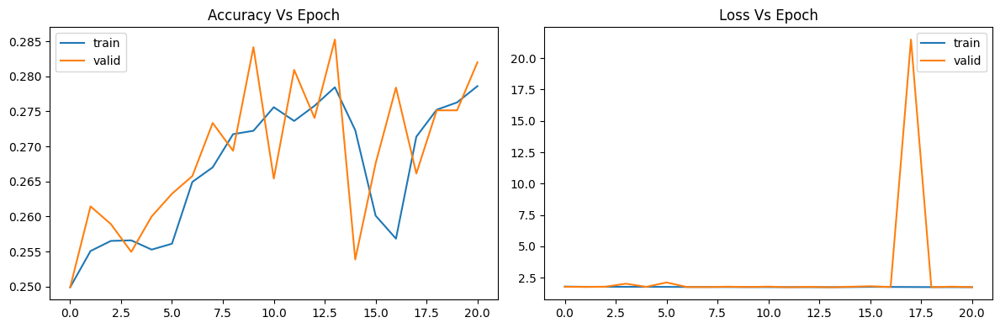

In [59]:
# Training Metrics
plot_metrics(cnn_history)

* ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** *
train data accuracy score: 0.3216160968375486
train data weighted f1 score: 0.26444420290218945


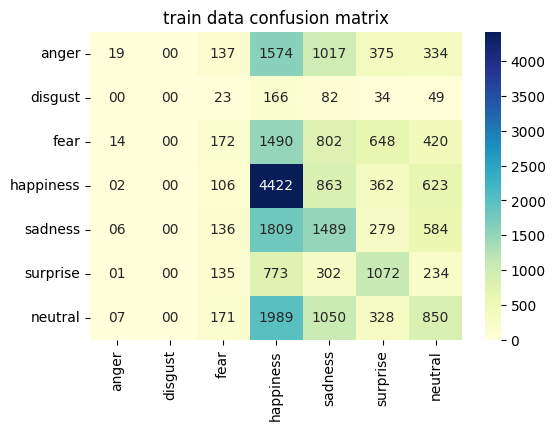

* ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** *
cv data accuracy score: 0.3137396321673278
cv data weighted f1 score: 0.25992668871692703


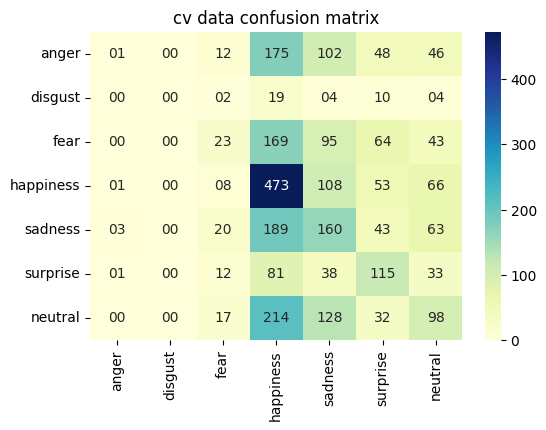

In [62]:
# Metrics
print_evaluation_metrics(y_train, train_pred, 'train')
print_evaluation_metrics(y_cv, cv_pred, 'cv')

* ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** *
test data accuracy score: 0.3240513634396191
test data weighted f1 score: 0.2655519458422188


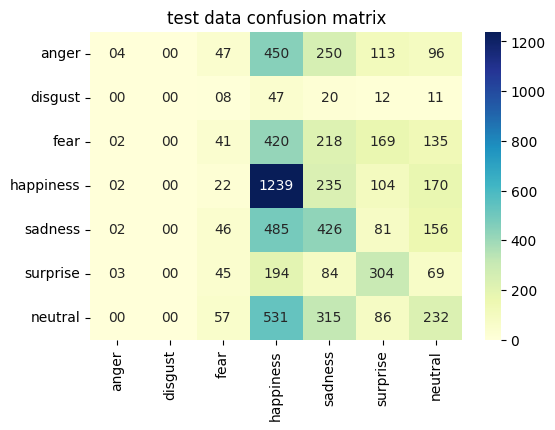

              precision    recall  f1-score   support

           0       0.31      0.00      0.01       960
           1       0.00      0.00      0.00        98
           2       0.15      0.04      0.07       985
           3       0.37      0.70      0.48      1772
           4       0.28      0.36      0.31      1196
           5       0.35      0.43      0.39       699
           6       0.27      0.19      0.22      1221

    accuracy                           0.32      6931
   macro avg       0.25      0.25      0.21      6931
weighted avg       0.29      0.32      0.27      6931



In [63]:
# Test Data Performance
print_evaluation_metrics(y_test, test_pred, 'test')
print(classification_report(y_test, test_pred))

###4. Transfer Learning using Pretrained CNN Model

**Train Test Split**

In [26]:
# Train Test Split (80-20 split)
X_train, X_test, y_train, y_test = train_test_split(img_data, labels, test_size=0.1, stratify=labels, random_state=42)

# Train CV Split (80-10 split)
#X_train, X_cv, y_train, y_cv = train_test_split(X_train, y_train, test_size=0.1, stratify=y_train, random_state=42)

# Shapes
print(f'X_train shape: {X_train.shape}')
#print(f'X_cv shape:    {X_cv.shape}')
print(f'X_test shape:  {X_test.shape}')
print(f'y_train shape: {y_train.shape}')
#print(f'y_cv shape:    {y_cv.shape}')
print(f'y_test shape:  {y_test.shape}')

X_train shape: (31187, 48, 48, 3)
X_test shape:  (3466, 48, 48, 3)
y_train shape: (31187,)
y_test shape:  (3466,)


**Encode class labels**

In [27]:
# Encode class labels
ohe = OneHotEncoder()
ohe.fit(np.array(y_train).reshape(-1, 1))

y_train_enc = ohe.transform(np.array(y_train).reshape(-1,1)).todense()
#y_cv_enc = ohe.transform(np.array(y_cv).reshape(-1,1)).todense()
y_test_enc = ohe.transform(np.array(y_test).reshape(-1,1)).todense()

# Shapes
print(f'y_train_enc shape: {y_train_enc.shape}')
#print(f'y_cv_enc shape: {y_cv_enc.shape}')
print(f'y_test_enc shape: {y_test_enc.shape}')

y_train_enc shape: (31187, 7)
y_test_enc shape: (3466, 7)


**Define Transfer Learning Network using VGG19 (Imagenet Weights)**

In [28]:
# Download pretrained VGG19 Model
vgg19 = tf.keras.applications.VGG19(weights = 'imagenet',
                                    include_top = False,
                                    input_shape = (48, 48, 3))

80134624/80134624 [==============================] - 5s 0us/step


In [29]:
# Prevent VGG layers training
for layer in vgg19.layers:
    layer.trainable = False

In [30]:
# VGG19 Architecture
vgg19.summary()

Model: "vgg19"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 48, 48, 3)]       0         
                                                                 
 block1_conv1 (Conv2D)       (None, 48, 48, 64)        1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 48, 48, 64)        36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 24, 24, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 24, 24, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 24, 24, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 12, 12, 128)       0     

In [31]:
# Define Classification Layer on top
vgg_output = vgg19.layers[-2].output
op = AveragePooling2D()(vgg_output)
op = Flatten()(op)
op = Dense(512, activation='relu')(op)
op = Dense(384, activation='relu')(op)
op = Dense(96, activation='relu')(op)
op = Dense(32, activation='relu')(op)
output = Dense(7, activation = 'softmax', name = 'output_layer')(op)

In [32]:
# Create Model
vgg_model = tf.keras.Model(inputs=vgg19.input, outputs=output)

In [33]:
# Model summary
vgg_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 48, 48, 3)]       0         
                                                                 
 block1_conv1 (Conv2D)       (None, 48, 48, 64)        1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 48, 48, 64)        36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 24, 24, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 24, 24, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 24, 24, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 12, 12, 128)       0     

**Data Augmentation**

In [34]:
# Define Data Generator
image_datagen = ImageDataGenerator(rescale=1./255,
                                   rotation_range = 15,
                                   width_shift_range = 0.15,
                                   height_shift_range = 0.15,
                                   shear_range = 0.15,
                                   zoom_range = 0.15,
                                   horizontal_flip = True,)
image_datagen.fit(X_train)

**Callbacks**

In [35]:
# Create necessary directories
os.makedirs('vgg_cnn/models', exist_ok=True)
os.makedirs('vgg_cnn/logs', exist_ok=True)

In [36]:
# Callbacks
saver = ModelCheckpoint('/content/vgg_cnn/models/model_{epoch:02d}.hdf5', monitor='val_accuracy', verbose=1, save_best_only=True)
stopper = EarlyStopping(monitor='val_accuracy', patience=11, min_delta = 0.00005, restore_best_weights=True, verbose=1)
reducer = ReduceLROnPlateau(monitor='val_accuracy', factor=0.5, patience=7, min_lr = 1e-7, verbose=1)
tb = TensorBoard(log_dir='/content/vgg_cnn/logs', histogram_freq=1)

callbacks = [saver, stopper, reducer, tb]

**Model Training**

In [39]:
# Params
optimizer = tf.keras.optimizers.Adam()
loss = 'categorical_crossentropy'
metrics = ['accuracy']
batch_size = 32
epochs = 100

In [40]:
# Compile Model
vgg_model.compile(optimizer=optimizer, loss=loss, metrics=metrics)

In [41]:
# Train Model
vgg_history = vgg_model.fit(image_datagen.flow(X_train, y_train_enc, batch_size = batch_size ),
                                       validation_data = image_datagen.flow(X_test, y_test_enc, batch_size = batch_size),
                                       steps_per_epoch = len(X_train) / batch_size ,
                                       epochs = epochs,
                                       callbacks = callbacks)

Epoch 1/100
974/974 [============================>.] - ETA: 0s - loss: 1.7128 - accuracy: 0.3058
Epoch 1: val_accuracy improved from -inf to 0.31852, saving model to /content/vgg_cnn/models/model_01.hdf5
974/974 [==============================] - 44s 35ms/step - loss: 1.7131 - accuracy: 0.3056 - val_loss: 1.6881 - val_accuracy: 0.3185 - lr: 0.0010
Epoch 2/100
974/974 [============================>.] - ETA: 0s - loss: 1.6742 - accuracy: 0.3251
Epoch 2: val_accuracy improved from 0.31852 to 0.32112, saving model to /content/vgg_cnn/models/model_02.hdf5
974/974 [==============================] - 33s 34ms/step - loss: 1.6742 - accuracy: 0.3251 - val_loss: 1.6706 - val_accuracy: 0.3211 - lr: 0.0010
Epoch 3/100
974/974 [============================>.] - ETA: 0s - loss: 1.6552 - accuracy: 0.3366
Epoch 3: val_accuracy improved from 0.32112 to 0.33930, saving model to /content/vgg_cnn/models/model_03.hdf5
974/974 [==============================] - 33s 34ms/step - loss: 1.6552 - accuracy: 0.3366

**Model Performace Metrics**

In [42]:
# Predictions
train_pred = np.argmax(vgg_model.predict(X_train*1./255), axis=1)
#cv_pred = np.argmax(vgg_model.predict(X_cv*1./255), axis=1)
test_pred = np.argmax(vgg_model.predict(X_test*1./255), axis=1)

109/109 [==============================] - 2s 14ms/step


In [43]:
# Tensorboard
%load_ext tensorboard
%tensorboard --logdir /content/vgg_cnn/logs

<IPython.core.display.Javascript object>

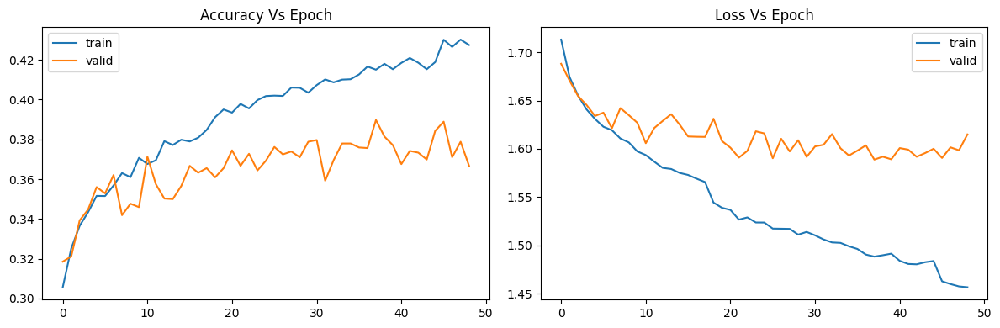

In [44]:
# Training Metrics
plot_metrics(vgg_history)

* ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** *
train data accuracy score: 0.4526244909738032
train data weighted f1 score: 0.435900908131837


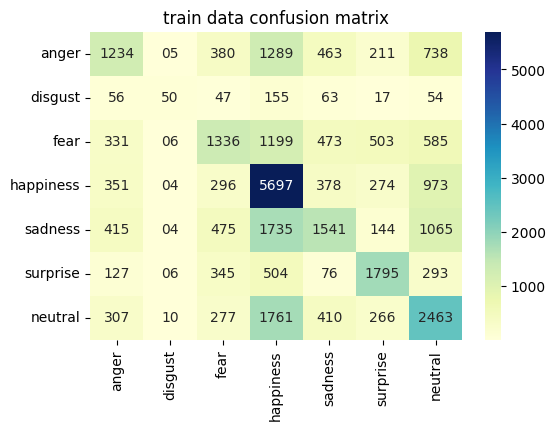

In [45]:
# Metrics
print_evaluation_metrics(y_train, train_pred, 'train')
#print_evaluation_metrics(y_cv, cv_pred, 'cv')

* ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** *
test data accuracy score: 0.39036353144835545
test data weighted f1 score: 0.3691946138861337


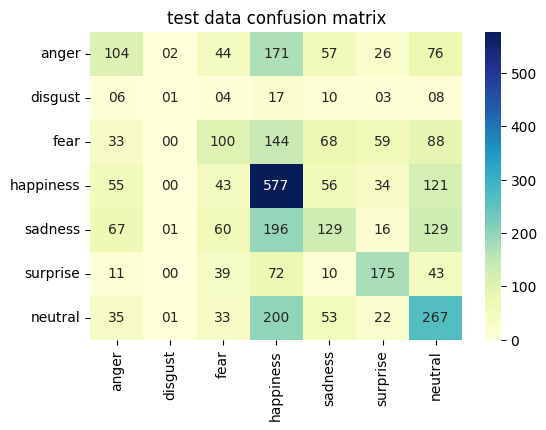

              precision    recall  f1-score   support

           0       0.33      0.22      0.26       480
           1       0.20      0.02      0.04        49
           2       0.31      0.20      0.25       492
           3       0.42      0.65      0.51       886
           4       0.34      0.22      0.26       598
           5       0.52      0.50      0.51       350
           6       0.36      0.44      0.40       611

    accuracy                           0.39      3466
   macro avg       0.36      0.32      0.32      3466
weighted avg       0.38      0.39      0.37      3466



In [46]:
# Test Data Performance
print_evaluation_metrics(y_test, test_pred, 'test')
print(classification_report(y_test, test_pred))

###5. Training VGG19 from scratch

**Train Test Split**

In [26]:
# Train Test Split (80-20 split)
X_train, X_test, y_train, y_test = train_test_split(img_data, labels, test_size=0.1, stratify=labels, random_state=42)

# Train CV Split (80-10 split)
#X_train, X_cv, y_train, y_cv = train_test_split(X_train, y_train, test_size=0.1, stratify=y_train, random_state=42)

# Shapes
print(f'X_train shape: {X_train.shape}')
#print(f'X_cv shape:    {X_cv.shape}')
print(f'X_test shape:  {X_test.shape}')
print(f'y_train shape: {y_train.shape}')
#print(f'y_cv shape:    {y_cv.shape}')
print(f'y_test shape:  {y_test.shape}')

X_train shape: (31187, 48, 48, 3)
X_test shape:  (3466, 48, 48, 3)
y_train shape: (31187,)
y_test shape:  (3466,)


**Encode class labels**

In [27]:
# Encode class labels
ohe = OneHotEncoder()
ohe.fit(np.array(y_train).reshape(-1, 1))

y_train_enc = ohe.transform(np.array(y_train).reshape(-1,1)).todense()
#y_cv_enc = ohe.transform(np.array(y_cv).reshape(-1,1)).todense()
y_test_enc = ohe.transform(np.array(y_test).reshape(-1,1)).todense()

# Shapes
print(f'y_train_enc shape: {y_train_enc.shape}')
#print(f'y_cv_enc shape: {y_cv_enc.shape}')
print(f'y_test_enc shape: {y_test_enc.shape}')

y_train_enc shape: (31187, 7)
y_test_enc shape: (3466, 7)


**Define Transfer Learning Network using VGG19 (Imagenet Weights)**

In [28]:
# Download pretrained VGG19 Model
vgg19 = tf.keras.applications.VGG19(weights = 'imagenet',
                                    include_top = False,
                                    input_shape = (48, 48, 3))

80134624/80134624 [==============================] - 3s 0us/step


In [29]:
# Prevent VGG layers training
# for layer in vgg19.layers:
#     layer.trainable = False

In [30]:
# VGG19 Architecture
vgg19.summary()

Model: "vgg19"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 48, 48, 3)]       0         
                                                                 
 block1_conv1 (Conv2D)       (None, 48, 48, 64)        1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 48, 48, 64)        36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 24, 24, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 24, 24, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 24, 24, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 12, 12, 128)       0     

In [31]:
# Define Classification Layer on top
vgg_output = vgg19.layers[-2].output
op = GlobalAveragePooling2D()(vgg_output)
output = Dense(7, activation = 'softmax', name = 'output_layer')(op)

In [32]:
# Create Model
full_vgg_model = tf.keras.Model(inputs=vgg19.input, outputs=output)

In [33]:
# Model summary
full_vgg_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 48, 48, 3)]       0         
                                                                 
 block1_conv1 (Conv2D)       (None, 48, 48, 64)        1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 48, 48, 64)        36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 24, 24, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 24, 24, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 24, 24, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 12, 12, 128)       0     

**Data Augmentation**

In [34]:
# Define Data Generator
image_datagen = ImageDataGenerator(rescale=1./255,
                                   rotation_range = 15,
                                   width_shift_range = 0.15,
                                   height_shift_range = 0.15,
                                   shear_range = 0.15,
                                   zoom_range = 0.15,
                                   horizontal_flip = True,)
image_datagen.fit(X_train)

**Callbacks**

In [35]:
# Create necessary directories
os.makedirs('full_vgg_cnn/models/', exist_ok=True)
os.makedirs('full_vgg_cnn/logs/', exist_ok=True)

In [36]:
# Callbacks
saver = ModelCheckpoint('/content/full_vgg_cnn/models/model_{epoch:02d}.hdf5', monitor='val_accuracy', verbose=1, save_best_only=True)
stopper = EarlyStopping(monitor='val_accuracy', patience=11, min_delta = 0.00005, restore_best_weights=True, verbose=1)
reducer = ReduceLROnPlateau(monitor='val_accuracy', factor=0.5, patience=7, min_lr = 1e-7, verbose=1)
tb = TensorBoard(log_dir='/content/full_vgg_cnn/logs', histogram_freq=1)

callbacks = [saver, stopper, reducer, tb]

**Model Training**

In [37]:
# Params
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.0001, beta_1 = 0.9, beta_2 = 0.999)
loss = 'categorical_crossentropy'
metrics = ['accuracy']
batch_size = 32
epochs = 50

In [38]:
# Compile Model
full_vgg_model.compile(optimizer=optimizer, loss=loss, metrics=metrics)

In [39]:
# Train Model
full_vgg_history = full_vgg_model.fit(image_datagen.flow(X_train, y_train_enc, batch_size = batch_size ),
                                       validation_data = image_datagen.flow(X_test, y_test_enc, batch_size = batch_size),
                                       steps_per_epoch = len(X_train) / batch_size ,
                                       epochs = epochs,
                                       callbacks = callbacks)

Epoch 1/50
975/974 [==============================] - ETA: 0s - loss: 1.4610 - accuracy: 0.4253
Epoch 1: val_accuracy improved from -inf to 0.48961, saving model to /content/full_vgg_cnn/models/model_01.hdf5
974/974 [==============================] - 66s 52ms/step - loss: 1.4610 - accuracy: 0.4253 - val_loss: 1.3201 - val_accuracy: 0.4896 - lr: 1.0000e-04
Epoch 2/50
975/974 [==============================] - ETA: 0s - loss: 1.2473 - accuracy: 0.5227
Epoch 2: val_accuracy improved from 0.48961 to 0.53433, saving model to /content/full_vgg_cnn/models/model_02.hdf5
974/974 [==============================] - 51s 52ms/step - loss: 1.2473 - accuracy: 0.5227 - val_loss: 1.2422 - val_accuracy: 0.5343 - lr: 1.0000e-04
Epoch 3/50
975/974 [==============================] - ETA: 0s - loss: 1.1650 - accuracy: 0.5615
Epoch 3: val_accuracy improved from 0.53433 to 0.53953, saving model to /content/full_vgg_cnn/models/model_03.hdf5
974/974 [==============================] - 52s 53ms/step - loss: 1.165

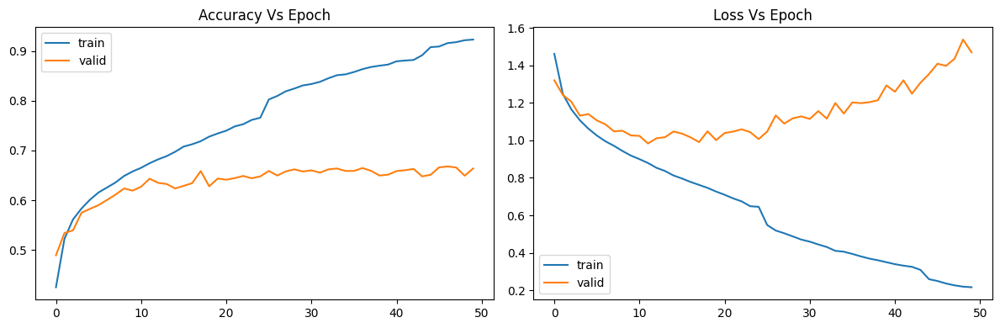

In [40]:
# Training Metrics
plot_metrics(full_vgg_history)

**Model Performace Metrics**

In [42]:
# Tensorboard
%load_ext tensorboard
%tensorboard --logdir /content/full_vgg_cnn/logs

<IPython.core.display.Javascript object>

In [45]:
# Load Epoch 18 (Best Model)
best_vgg = tf.keras.models.load_model('/content/full_vgg_cnn/models/model_18.hdf5')

In [46]:
# Predictions
train_pred = np.argmax(best_vgg.predict(X_train*1./255), axis=1)
#cv_pred = np.argmax(vgg_model.predict(X_cv*1./255), axis=1)
test_pred = np.argmax(best_vgg.predict(X_test*1./255), axis=1)

109/109 [==============================] - 1s 13ms/step


* ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** *
train data accuracy score: 0.7594831179658191
train data weighted f1 score: 0.755805075671032


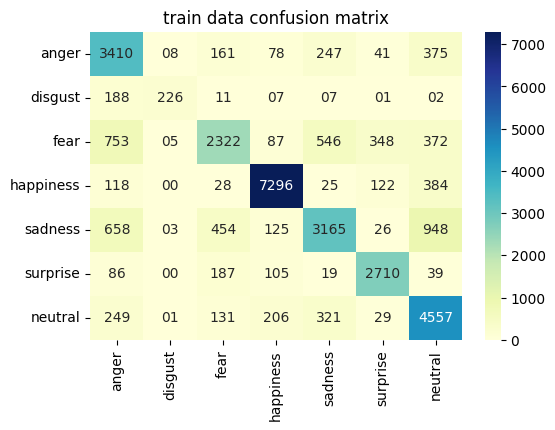

In [47]:
# Metrics
print_evaluation_metrics(y_train, train_pred, 'train')
#print_evaluation_metrics(y_cv, cv_pred, 'cv')

* ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** *
test data accuracy score: 0.6638776687824581
test data weighted f1 score: 0.6599664679499141


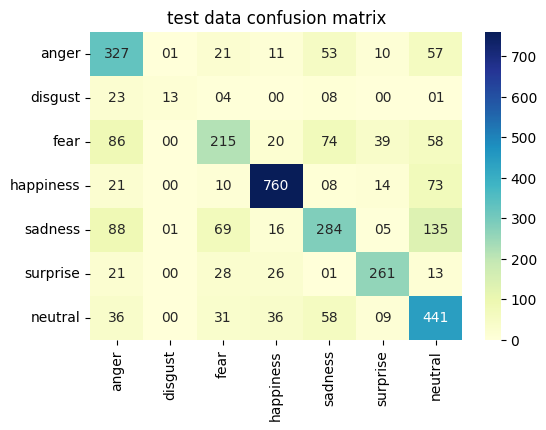

              precision    recall  f1-score   support

           0       0.54      0.68      0.60       480
           1       0.87      0.27      0.41        49
           2       0.57      0.44      0.49       492
           3       0.87      0.86      0.87       886
           4       0.58      0.47      0.52       598
           5       0.77      0.75      0.76       350
           6       0.57      0.72      0.63       611

    accuracy                           0.66      3466
   macro avg       0.68      0.60      0.61      3466
weighted avg       0.67      0.66      0.66      3466



In [48]:
# Test Data Performance
print_evaluation_metrics(y_test, test_pred, 'test')
print(classification_report(y_test, test_pred))

### Model Experiments Summary

In [49]:
from prettytable import PrettyTable

# Specify the Column Names while initializing the Table
summary = PrettyTable(["Model Info", "Test Accuracy", "Test Weighted F1 "])

# Add rows
summary.add_row(["SVM Classifier", "0.43", "0.40"])
summary.add_row(["MLP Model", "0.33", "0.26"])
summary.add_row(["Custom CNN", "0.32", "0.27"])
summary.add_row(["Transfer Learning (VGG19)", "0.39", "0.37"])
summary.add_row(["Fully Trained VGG19", "0.66", "0.66"])

print("Model Experiments Summary: ")
print(summary)

Model Experiments Summary: 
+---------------------------+---------------+-------------------+
|         Model Info        | Test Accuracy | Test Weighted F1  |
+---------------------------+---------------+-------------------+
|       SVM Classifier      |      0.43     |        0.40       |
|         MLP Model         |      0.33     |        0.26       |
|         Custom CNN        |      0.32     |        0.27       |
| Transfer Learning (VGG19) |      0.39     |        0.37       |
|    Fully Trained VGG19    |      0.66     |        0.66       |
+---------------------------+---------------+-------------------+


AS we can observe in the summary table, fully trained VGG19 from scratch showed best performance on test data. This model can be fine-tuned further to improve performance.

### Fine Tuning Best Model

With my experimentation till now, we could find best model as VGG19.

It can further be experimented with different batch_sizes, epochs, learning_rates, optimizers and augmentation parameters.

##**Best Model Performance Analysis**

In [ ]:
# Load Epoch 18 (Best Model)
best_vgg = tf.keras.models.load_model('/content/full_vgg_cnn/models/model_18.hdf5')

In [ ]:
# Predictions
train_pred = np.argmax(best_vgg.predict(X_train*1./255), axis=1)
#cv_pred = np.argmax(vgg_model.predict(X_cv*1./255), axis=1)
test_pred = np.argmax(best_vgg.predict(X_test*1./255), axis=1)

109/109 [==============================] - 1s 13ms/step


* ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** *
train data accuracy score: 0.7594831179658191
train data weighted f1 score: 0.755805075671032


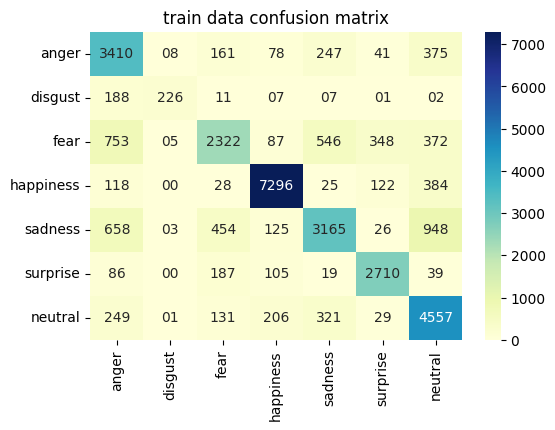

In [ ]:
# Metrics
print_evaluation_metrics(y_train, train_pred, 'train')
#print_evaluation_metrics(y_cv, cv_pred, 'cv')

* ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** ** *
test data accuracy score: 0.6638776687824581
test data weighted f1 score: 0.6599664679499141


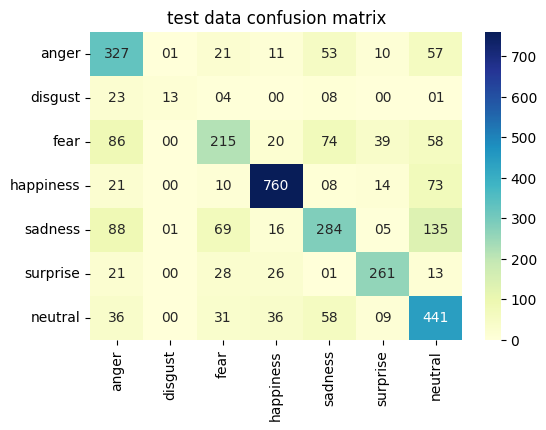

              precision    recall  f1-score   support

           0       0.54      0.68      0.60       480
           1       0.87      0.27      0.41        49
           2       0.57      0.44      0.49       492
           3       0.87      0.86      0.87       886
           4       0.58      0.47      0.52       598
           5       0.77      0.75      0.76       350
           6       0.57      0.72      0.63       611

    accuracy                           0.66      3466
   macro avg       0.68      0.60      0.61      3466
weighted avg       0.67      0.66      0.66      3466



In [ ]:
# Test Data Performance
print_evaluation_metrics(y_test, test_pred, 'test')
print(classification_report(y_test, test_pred))

**BEST MODEL REMARKS:**

1. Our model is best able to detect happiness with 87% f1 score.
2. It can also detect surprise, neutral with moderate performance at 76%, 63% and 60% f1 score respectively.
3. Model is confused between sadness-neutral, anger-sadness, anger-fear.

Adding more data and/or further tuning/experimenting can improve model performance.

##**Future Scope**

1. Different state of the art CNN Models like VGGFace, InceptionV3,  ResNet, EfficientNet etc. can be experimented.
2. Transfer learning techniques can be used with more prominent dense layers and enabling tarining for bottom 10-15% layers.
3. Different more deeper architectures can be tried for MLP and Custom CNN networks .
4. Other ML algorithms with different hyperparameters can be experimented with for MultiClass Classification.
5. Some emotions like sadness and neutral look similar for some people, combining these to labels could improve overall model performance.

## **Bonus Task**

The Emotion Detection from Webcam feed is Implemented at following Github repo link.

Link: https://github.com/theingale/face_emotion_detection